In [1]:
import os
import random as random
import datetime
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
import torchvision.transforms as transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image
import matplotlib.pyplot as plt

In [2]:
data_dir = '/home/ec2-user/SageMaker/OpenCV/512_final/'
save_dir = '/home/ec2-user/SageMaker/OpenCV/checkpoints'

In [3]:
image_files_original = sorted([f for f in os.listdir(os.path.join(data_dir, 'images')) if f.endswith(('.png', '.jpg', '.jpeg'))])
image_files_augmented = sorted([f for f in os.listdir(os.path.join(data_dir, 'images_agumented')) if f.endswith(('.png', '.jpg', '.jpeg'))])
image_files =  image_files_augmented + image_files_original
# Load masks from the original and augmented folders
mask_files_original = sorted([f for f in os.listdir(os.path.join(data_dir, 'masks')) if f.endswith(('.png', '.jpg', '.jpeg'))])
mask_files_augmented = sorted([f for f in os.listdir(os.path.join(data_dir, 'masks_agumented')) if f.endswith(('.png', '.jpg', '.jpeg'))])
mask_files =   mask_files_augmented + mask_files_original

In [4]:
train_ratio = 0.8
val_ratio = 0.10
test_ratio = 0.10

In [5]:
total_samples = len(image_files)
train_samples = int(total_samples * train_ratio)
val_samples = int(total_samples * val_ratio)
test_samples = total_samples - train_samples - val_samples

train_images = image_files[:train_samples]
train_masks = mask_files[:train_samples]

val_images = image_files[train_samples:train_samples + val_samples]
val_masks = mask_files[train_samples:train_samples + val_samples]

test_images = image_files[train_samples + val_samples:]
test_masks = mask_files[train_samples + val_samples:]

In [6]:
class CustomDataset(Dataset):
    def __init__(self, image_files, mask_files, data_dir, transform=None):
        self.image_files = image_files
        self.mask_files = mask_files
        self.data_dir = data_dir
        self.transform = transform

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, index):
        original_image_path = os.path.join(self.data_dir, 'images', self.image_files[index])
        original_mask_path = os.path.join(self.data_dir, 'masks', self.mask_files[index])

        augmented_image_path = os.path.join(self.data_dir, 'images_agumented', self.image_files[index])
        augmented_mask_path = os.path.join(self.data_dir, 'masks_agumented', self.mask_files[index])

        if os.path.exists(original_image_path) and os.path.exists(original_mask_path):
            image_path = original_image_path
            mask_path = original_mask_path
        elif os.path.exists(augmented_image_path) and os.path.exists(augmented_mask_path):
            image_path = augmented_image_path
            mask_path = augmented_mask_path
        else:
            print(original_image_path)
            print(original_mask_path)
            print(augmented_image_path)
            print(augmented_mask_path)
            raise FileNotFoundError(f"Image and mask not found for index {index}.")

        image = Image.open(image_path).convert("RGB")  # Convert to RGB mode
        mask = Image.open(mask_path).convert("L")  # Convert to grayscale mode

        if self.transform:
            image = self.transform(image)
            mask = self.transform(mask)

        return image, mask


In [7]:
# import os
# from PIL import Image
# from torch.utils.data import Dataset
# from torchvision import transforms
# import random

# class CustomDataset(Dataset):
#     def __init__(self, image_files, mask_files, data_dir, num_augmentations=3, transform=None):
#         self.image_files = image_files
#         self.mask_files = mask_files
#         self.data_dir = data_dir
#         self.num_augmentations = num_augmentations
#         self.transform = transform

#     def __len__(self):
#         return len(self.image_files) * self.num_augmentations

#     def __getitem__(self, index):
#         idx = index // self.num_augmentations  # Calculate the original index
#         image_path = os.path.join(self.data_dir, 'images', self.image_files[idx])
#         mask_path = os.path.join(self.data_dir, 'masks', self.mask_files[idx])

#         image = Image.open(image_path).convert("RGB")  # Convert to RGB mode
#         mask = Image.open(mask_path).convert("L")  # Convert to grayscale mode

#         if self.transform:
#             # Augmentations for image and mask should be same, so we apply the same seed for both
#             seed = random.randint(0, 2**32)
#             random.seed(seed)
#             image = self.transform(image)
            
#             random.seed(seed)  # Reset the seed to apply the same augmentation for the mask
#             mask = self.transform(mask)

#         return image, mask


In [8]:
from torchvision import transforms

transform = transforms.Compose([
    # transforms.Resize((256, 256)),  # Resize to 256x256
    # transforms.RandomHorizontalFlip(),  # Random horizontal flip
    # transforms.RandomVerticalFlip(),    # Random vertical flip
    # transforms.RandomRotation(15),      # Random rotation within -15 to +15 degrees
    # transforms.ColorJitter(brightness=0.2, contrast=0.2),  # Random brightness and contrast adjustments
    transforms.ToTensor(),  # Convert to tensor
])


In [9]:
# transform = transforms.Compose([
#     transforms.RandomHorizontalFlip(),
#     transforms.RandomVerticalFlip(),
#     transforms.RandomRotation(degrees=20),
#     transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
#     transforms.ToTensor()
# ])

In [10]:
train_dataset = CustomDataset(train_images, train_masks, data_dir, transform)
train_loader = DataLoader(train_dataset, batch_size=16, shuffle=True)

# Validation dataset and data loader
val_dataset = CustomDataset(val_images, val_masks, data_dir,  transform)
val_loader = DataLoader(val_dataset, batch_size=16, shuffle=True)

# Test dataset and data loader
test_dataset = CustomDataset(test_images, test_masks, data_dir, transform)
test_loader = DataLoader(test_dataset, batch_size=16, shuffle=True)

In [11]:
# import torch
# import torch.nn as nn

# def init_conv_weights(m):
#     if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
#         nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
#         if m.bias is not None:
#             nn.init.zeros_(m.bias)

# class UNet(nn.Module):
#     def __init__(self, input_channels=3, start_neurons=16):
#         super(UNet, self).__init__()

#         # Encoder
#         self.conv1 = nn.Conv2d(input_channels, start_neurons, kernel_size=3, padding=1)
#         self.conv1_bn = nn.BatchNorm2d(start_neurons)
#         self.conv1_1 = nn.Conv2d(start_neurons, start_neurons, kernel_size=3, padding=1)
#         self.conv1_1_bn = nn.BatchNorm2d(start_neurons)
#         self.pool1 = nn.MaxPool2d(2, 2)

#         self.conv2 = nn.Conv2d(start_neurons, start_neurons * 2, kernel_size=3, padding=1)
#         self.conv2_bn = nn.BatchNorm2d(start_neurons * 2)
#         self.conv2_1 = nn.Conv2d(start_neurons * 2, start_neurons * 2, kernel_size=3, padding=1)
#         self.conv2_1_bn = nn.BatchNorm2d(start_neurons * 2)
#         self.pool2 = nn.MaxPool2d(2, 2)

#         self.conv3 = nn.Conv2d(start_neurons * 2, start_neurons * 4, kernel_size=3, padding=1)
#         self.conv3_bn = nn.BatchNorm2d(start_neurons * 4)
#         self.conv3_1 = nn.Conv2d(start_neurons * 4, start_neurons * 4, kernel_size=3, padding=1)
#         self.conv3_1_bn = nn.BatchNorm2d(start_neurons * 4)
#         self.pool3 = nn.MaxPool2d(2, 2)

#         self.conv4 = nn.Conv2d(start_neurons * 4, start_neurons * 8, kernel_size=3, padding=1)
#         self.conv4_bn = nn.BatchNorm2d(start_neurons * 8)
#         self.conv4_1 = nn.Conv2d(start_neurons * 8, start_neurons * 8, kernel_size=3, padding=1)
#         self.conv4_1_bn = nn.BatchNorm2d(start_neurons * 8)
#         self.pool4 = nn.MaxPool2d(2, 2)

#         # Middle
#         self.middle_conv1 = nn.Conv2d(start_neurons * 8, start_neurons * 16, kernel_size=3, padding=1)
#         self.middle_conv1_bn = nn.BatchNorm2d(start_neurons * 16)
#         self.middle_conv1_1 = nn.Conv2d(start_neurons * 16, start_neurons * 16, kernel_size=3, padding=1)
#         self.middle_conv1_1_bn = nn.BatchNorm2d(start_neurons * 16)

#         # Decoder
#         self.deconv4 = nn.ConvTranspose2d(start_neurons * 16, start_neurons * 8, kernel_size=2, stride=2)
#         self.conv_up4_1 = nn.Conv2d(start_neurons * 16, start_neurons * 8, kernel_size=3, padding=1)
#         self.conv_up4_1_bn = nn.BatchNorm2d(start_neurons * 8)
#         self.conv_up4_2 = nn.Conv2d(start_neurons * 8, start_neurons * 8, kernel_size=3, padding=1)
#         self.conv_up4_2_bn = nn.BatchNorm2d(start_neurons * 8)

#         self.deconv3 = nn.ConvTranspose2d(start_neurons * 8, start_neurons * 4, kernel_size=2, stride=2)
#         self.conv_up3_1 = nn.Conv2d(start_neurons * 8, start_neurons * 4, kernel_size=3, padding=1)
#         self.conv_up3_1_bn = nn.BatchNorm2d(start_neurons * 4)
#         self.conv_up3_2 = nn.Conv2d(start_neurons * 4, start_neurons * 4, kernel_size=3, padding=1)
#         self.conv_up3_2_bn = nn.BatchNorm2d(start_neurons * 4)

#         self.deconv2 = nn.ConvTranspose2d(start_neurons * 4, start_neurons * 2, kernel_size=2, stride=2)
#         self.conv_up2_1 = nn.Conv2d(start_neurons * 4, start_neurons * 2, kernel_size=3, padding=1)
#         self.conv_up2_1_bn = nn.BatchNorm2d(start_neurons * 2)
#         self.conv_up2_2 = nn.Conv2d(start_neurons * 2, start_neurons * 2, kernel_size=3, padding=1)
#         self.conv_up2_2_bn = nn.BatchNorm2d(start_neurons * 2)

#         self.deconv1 = nn.ConvTranspose2d(start_neurons * 2, start_neurons, kernel_size=2, stride=2)
#         self.conv_up1_1 = nn.Conv2d(start_neurons * 2, start_neurons, kernel_size=3, padding=1)
#         self.conv_up1_1_bn = nn.BatchNorm2d(start_neurons)
#         self.conv_up1_2 = nn.Conv2d(start_neurons, start_neurons, kernel_size=3, padding=1)
#         self.conv_up1_2_bn = nn.BatchNorm2d(start_neurons)

#         # Output layer
#         self.output_layer = nn.Conv2d(start_neurons, 1, kernel_size=1)

#         # Initialize weights with identity matrices
#         self.apply(init_conv_weights)

#     def forward(self, x):
#         # Encoder
#         conv1 = nn.ReLU(inplace=True)(self.conv1_bn(self.conv1(x)))
#         conv1 = nn.ReLU(inplace=True)(self.conv1_1_bn(self.conv1_1(conv1)))
#         pool1 = self.pool1(conv1)

#         conv2 = nn.ReLU(inplace=True)(self.conv2_bn(self.conv2(pool1)))
#         conv2 = nn.ReLU(inplace=True)(self.conv2_1_bn(self.conv2_1(conv2)))
#         pool2 = self.pool2(conv2)

#         conv3 = nn.ReLU(inplace=True)(self.conv3_bn(self.conv3(pool2)))
#         conv3 = nn.ReLU(inplace=True)(self.conv3_1_bn(self.conv3_1(conv3)))
#         pool3 = self.pool3(conv3)

#         conv4 = nn.ReLU(inplace=True)(self.conv4_bn(self.conv4(pool3)))
#         conv4 = nn.ReLU(inplace=True)(self.conv4_1_bn(self.conv4_1(conv4)))
#         pool4 = self.pool4(conv4)

#         # Middle
#         middle = nn.ReLU(inplace=True)(self.middle_conv1_bn(self.middle_conv1(pool4)))
#         middle = nn.ReLU(inplace=True)(self.middle_conv1_1_bn(self.middle_conv1_1(middle)))

#         # Decoder
#         deconv4 = self.deconv4(middle)
#         concat4 = torch.cat([deconv4, conv4], dim=1)
#         conv_up4 = nn.ReLU(inplace=True)(self.conv_up4_1_bn(self.conv_up4_1(concat4)))
#         conv_up4 = nn.ReLU(inplace=True)(self.conv_up4_2_bn(self.conv_up4_2(conv_up4)))

#         deconv3 = self.deconv3(conv_up4)
#         concat3 = torch.cat([deconv3, conv3], dim=1)
#         conv_up3 = nn.ReLU(inplace=True)(self.conv_up3_1_bn(self.conv_up3_1(concat3)))
#         conv_up3 = nn.ReLU(inplace=True)(self.conv_up3_2_bn(self.conv_up3_2(conv_up3)))

#         deconv2 = self.deconv2(conv_up3)
#         concat2 = torch.cat([deconv2, conv2], dim=1)
#         conv_up2 = nn.ReLU(inplace=True)(self.conv_up2_1_bn(self.conv_up2_1(concat2)))
#         conv_up2 = nn.ReLU(inplace=True)(self.conv_up2_2_bn(self.conv_up2_2(conv_up2)))

#         deconv1 = self.deconv1(conv_up2)
#         concat1 = torch.cat([deconv1, conv1], dim=1)
#         conv_up1 = nn.ReLU(inplace=True)(self.conv_up1_1_bn(self.conv_up1_1(concat1)))
#         conv_up1 = nn.ReLU(inplace=True)(self.conv_up1_2_bn(self.conv_up1_2(conv_up1)))

#         # Output layer
#         output = self.output_layer(conv_up1)

#         return output


In [12]:
import torch
import torch.nn as nn

def init_conv_weights(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
        if m.bias is not None:
            nn.init.zeros_(m.bias)

class UNet(nn.Module):
    def __init__(self, input_channels=3, start_neurons=16, dropout_rate=0.0):
        super(UNet, self).__init__()

        # Encoder
        self.conv1 = nn.Conv2d(input_channels, start_neurons, kernel_size=3, padding=1)
        self.conv1_bn = nn.BatchNorm2d(start_neurons)
        self.conv1_1 = nn.Conv2d(start_neurons, start_neurons, kernel_size=3, padding=1)
        self.conv1_1_bn = nn.BatchNorm2d(start_neurons)
        self.pool1 = nn.MaxPool2d(4, 4)  # Updated kernel_size and stride
        self.dropout1 = nn.Dropout2d(p=dropout_rate)  # Dropout layer added

        self.conv2 = nn.Conv2d(start_neurons, start_neurons * 2, kernel_size=3, padding=1)
        self.conv2_bn = nn.BatchNorm2d(start_neurons * 2)
        self.conv2_1 = nn.Conv2d(start_neurons * 2, start_neurons * 2, kernel_size=3, padding=1)
        self.conv2_1_bn = nn.BatchNorm2d(start_neurons * 2)
        self.pool2 = nn.MaxPool2d(4, 4)  # Updated kernel_size and stride
        self.dropout2 = nn.Dropout2d(p=dropout_rate)  # Dropout layer added

        self.conv3 = nn.Conv2d(start_neurons * 2, start_neurons * 4, kernel_size=3, padding=1)
        self.conv3_bn = nn.BatchNorm2d(start_neurons * 4)
        self.conv3_1 = nn.Conv2d(start_neurons * 4, start_neurons * 4, kernel_size=3, padding=1)
        self.conv3_1_bn = nn.BatchNorm2d(start_neurons * 4)
        self.pool3 = nn.MaxPool2d(4, 4)  # Updated kernel_size and stride
        self.dropout3 = nn.Dropout2d(p=dropout_rate)  # Dropout layer added

        self.conv4 = nn.Conv2d(start_neurons * 4, start_neurons * 8, kernel_size=3, padding=1)
        self.conv4_bn = nn.BatchNorm2d(start_neurons * 8)
        self.conv4_1 = nn.Conv2d(start_neurons * 8, start_neurons * 8, kernel_size=3, padding=1)
        self.conv4_1_bn = nn.BatchNorm2d(start_neurons * 8)
        self.pool4 = nn.MaxPool2d(4, 4)  # Updated kernel_size and stride
        self.dropout4 = nn.Dropout2d(p=dropout_rate)  # Dropout layer added

        # Middle
        self.middle_conv1 = nn.Conv2d(start_neurons * 8, start_neurons * 16, kernel_size=3, padding=1)
        self.middle_conv1_bn = nn.BatchNorm2d(start_neurons * 16)
        self.middle_conv1_1 = nn.Conv2d(start_neurons * 16, start_neurons * 16, kernel_size=3, padding=1)
        self.middle_conv1_1_bn = nn.BatchNorm2d(start_neurons * 16)
        self.dropout_middle = nn.Dropout2d(p=dropout_rate)  # Dropout layer added

        # Decoder
        self.deconv4 = nn.ConvTranspose2d(start_neurons * 16, start_neurons * 8, kernel_size=4, stride=4)  # Updated kernel_size and stride
        self.conv_up4_1 = nn.Conv2d(start_neurons * 16, start_neurons * 8, kernel_size=3, padding=1)
        self.conv_up4_1_bn = nn.BatchNorm2d(start_neurons * 8)
        self.conv_up4_2 = nn.Conv2d(start_neurons * 8, start_neurons * 8, kernel_size=3, padding=1)
        self.conv_up4_2_bn = nn.BatchNorm2d(start_neurons * 8)

        self.deconv3 = nn.ConvTranspose2d(start_neurons * 8, start_neurons * 4, kernel_size=4, stride=4)  # Updated kernel_size and stride
        self.conv_up3_1 = nn.Conv2d(start_neurons * 8, start_neurons * 4, kernel_size=3, padding=1)
        self.conv_up3_1_bn = nn.BatchNorm2d(start_neurons * 4)
        self.conv_up3_2 = nn.Conv2d(start_neurons * 4, start_neurons * 4, kernel_size=3, padding=1)
        self.conv_up3_2_bn = nn.BatchNorm2d(start_neurons * 4)

        self.deconv2 = nn.ConvTranspose2d(start_neurons * 4, start_neurons * 2, kernel_size=4, stride=4)  # Updated kernel_size and stride
        self.conv_up2_1 = nn.Conv2d(start_neurons * 4, start_neurons * 2, kernel_size=3, padding=1)
        self.conv_up2_1_bn = nn.BatchNorm2d(start_neurons * 2)
        self.conv_up2_2 = nn.Conv2d(start_neurons * 2, start_neurons * 2, kernel_size=3, padding=1)
        self.conv_up2_2_bn = nn.BatchNorm2d(start_neurons * 2)

        self.deconv1 = nn.ConvTranspose2d(start_neurons * 2, start_neurons, kernel_size=4, stride=4)  # Updated kernel_size and stride
        self.conv_up1_1 = nn.Conv2d(start_neurons * 2, start_neurons, kernel_size=3, padding=1)
        self.conv_up1_1_bn = nn.BatchNorm2d(start_neurons)
        self.conv_up1_2 = nn.Conv2d(start_neurons, start_neurons, kernel_size=3, padding=1)
        self.conv_up1_2_bn = nn.BatchNorm2d(start_neurons)

        # Output layer
        self.output_layer = nn.Conv2d(start_neurons, 1, kernel_size=1)

        # Initialize weights with identity matrices
        self.apply(init_conv_weights)

    def forward(self, x):
        # Encoder
        conv1 = nn.ReLU(inplace=True)(self.conv1_bn(self.conv1(x)))
        conv1 = nn.ReLU(inplace=True)(self.conv1_1_bn(self.conv1_1(conv1)))
        pool1 = self.pool1(conv1)
        pool1 = self.dropout1(pool1)  # Dropout added

        conv2 = nn.ReLU(inplace=True)(self.conv2_bn(self.conv2(pool1)))
        conv2 = nn.ReLU(inplace=True)(self.conv2_1_bn(self.conv2_1(conv2)))
        pool2 = self.pool2(conv2)
        pool2 = self.dropout2(pool2)  # Dropout added

        conv3 = nn.ReLU(inplace=True)(self.conv3_bn(self.conv3(pool2)))
        conv3 = nn.ReLU(inplace=True)(self.conv3_1_bn(self.conv3_1(conv3)))
        pool3 = self.pool3(conv3)
        pool3 = self.dropout3(pool3)  # Dropout added

        conv4 = nn.ReLU(inplace=True)(self.conv4_bn(self.conv4(pool3)))
        conv4 = nn.ReLU(inplace=True)(self.conv4_1_bn(self.conv4_1(conv4)))
        pool4 = self.pool4(conv4)
        pool4 = self.dropout4(pool4)  # Dropout added

        # Middle
        middle = nn.ReLU(inplace=True)(self.middle_conv1_bn(self.middle_conv1(pool4)))
        middle = nn.ReLU(inplace=True)(self.middle_conv1_1_bn(self.middle_conv1_1(middle)))
        middle = self.dropout_middle(middle)  # Dropout added

        # Decoder
        deconv4 = self.deconv4(middle)
        concat4 = torch.cat([deconv4, conv4], dim=1)
        conv_up4 = nn.ReLU(inplace=True)(self.conv_up4_1_bn(self.conv_up4_1(concat4)))
        conv_up4 = nn.ReLU(inplace=True)(self.conv_up4_2_bn(self.conv_up4_2(conv_up4)))

        deconv3 = self.deconv3(conv_up4)
        concat3 = torch.cat([deconv3, conv3], dim=1)
        conv_up3 = nn.ReLU(inplace=True)(self.conv_up3_1_bn(self.conv_up3_1(concat3)))
        conv_up3 = nn.ReLU(inplace=True)(self.conv_up3_2_bn(self.conv_up3_2(conv_up3)))

        deconv2 = self.deconv2(conv_up3)
        concat2 = torch.cat([deconv2, conv2], dim=1)
        conv_up2 = nn.ReLU(inplace=True)(self.conv_up2_1_bn(self.conv_up2_1(concat2)))
        conv_up2 = nn.ReLU(inplace=True)(self.conv_up2_2_bn(self.conv_up2_2(conv_up2)))

        deconv1 = self.deconv1(conv_up2)
        concat1 = torch.cat([deconv1, conv1], dim=1)
        conv_up1 = nn.ReLU(inplace=True)(self.conv_up1_1_bn(self.conv_up1_1(concat1)))
        conv_up1 = nn.ReLU(inplace=True)(self.conv_up1_2_bn(self.conv_up1_2(conv_up1)))

        # Output layer
        output = self.output_layer(conv_up1)

        return output


In [13]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import clear_output

# Custom progress bar to display training progress
def custom_progress_bar(epoch, num_epochs, train_loss, val_loss):
    print(f'Epoch {epoch + 1}/{num_epochs}, Train Loss: {train_loss:.4f}, Val Loss: {val_loss:.4f}')

def train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs=10):
    model.train()

    train_losses = []
    val_losses = []

    for epoch in range(num_epochs):
        running_loss = 0.0

        for images, masks in train_loader:
            images = images.to(device)
            masks = masks.to(device)

            optimizer.zero_grad()

            outputs = model(images)
            loss = criterion(outputs, masks)
            loss.backward()

            optimizer.step()

            running_loss += loss.item()

        # Calculate and print total loss for each epoch
        epoch_loss = running_loss
        train_losses.append(epoch_loss)

        # Validate the model after each epoch
        val_loss = validate_model(model, criterion, val_loader)
        val_losses.append(val_loss)

        # Update the custom progress bar
        custom_progress_bar(epoch, num_epochs, epoch_loss, val_loss)
    
    # Call this function after training to save the model checkpoint
    save_checkpoint(model, optimizer, save_dir=save_dir)
    # Plot the training progress
    plt.figure(figsize=(8, 5))
    plt.plot(range(1, num_epochs + 1), train_losses, label='Train Loss')
    plt.plot(range(1, num_epochs + 1), val_losses, label='Validation Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

def validate_model(model, criterion, val_loader):
    model.eval()
    val_loss = 0.0

    with torch.no_grad():
        for images, masks in val_loader:
            images = images.to(device)
            masks = masks.to(device)

            outputs = model(images)
            val_loss += criterion(outputs, masks).item()

    val_loss /= len(val_loader)
    model.train()
    return val_loss

# Step 8: Test the model and visualize the results
def test_model(model, test_loader):
    model.eval()

    with torch.no_grad():
        for images, masks in test_loader:
            images = images.to(device)
            masks = masks.to(device)

            outputs = model(images)
            predicted_masks = (outputs > 0.5).float()  # Assuming binary segmentation

            # Visualize the true and predicted segmented images
            for i in range(images.size(0)):
                plt.figure(figsize=(12, 6))
                plt.subplot(1, 3, 1)
                plt.title("Input Image")
                plt.imshow(images[i].cpu().permute(1, 2, 0))
                plt.axis('off')

                plt.subplot(1, 3, 2)
                plt.title("True Mask")
                plt.imshow(masks[i].cpu().squeeze(), cmap='gray')
                plt.axis('off')

                plt.subplot(1, 3, 3)
                plt.title("Predicted Mask")
                plt.imshow(predicted_masks[i].cpu().squeeze(), cmap='gray')
                plt.axis('off')

                plt.show()


# Function to save the model checkpoint
def save_checkpoint(model, optimizer, save_dir):
    # Create the directory if it doesn't exist
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    # Generate a filename based on the current date and time
    current_time = datetime.datetime.now().strftime("%Y-%m-%d_%H-%M-%S")
    filename = f"checkpoint_{current_time}.pt"

    # Create a dictionary containing the model state and optimizer state
    checkpoint = {
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
    }

    # Save the checkpoint to the specified directory
    filepath = os.path.join(save_dir, filename)
    torch.save(checkpoint, filepath)
    print(f"Model checkpoint saved at: {filepath}")




In [14]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

Epoch 1/100, Train Loss: 40.0270, Val Loss: 0.0708
Epoch 2/100, Train Loss: 10.7234, Val Loss: 0.0471
Epoch 3/100, Train Loss: 8.0336, Val Loss: 0.0368
Epoch 4/100, Train Loss: 7.0807, Val Loss: 0.0354
Epoch 5/100, Train Loss: 6.2314, Val Loss: 0.0316
Epoch 6/100, Train Loss: 5.6586, Val Loss: 0.0294
Epoch 7/100, Train Loss: 5.1349, Val Loss: 0.0271
Epoch 8/100, Train Loss: 4.6111, Val Loss: 0.0235
Epoch 9/100, Train Loss: 4.4541, Val Loss: 0.0274
Epoch 10/100, Train Loss: 4.2228, Val Loss: 0.0218
Epoch 11/100, Train Loss: 4.4701, Val Loss: 0.0292
Epoch 12/100, Train Loss: 4.2555, Val Loss: 0.0239
Epoch 13/100, Train Loss: 3.6398, Val Loss: 0.0190
Epoch 14/100, Train Loss: 3.4639, Val Loss: 0.0201
Epoch 15/100, Train Loss: 3.2612, Val Loss: 0.0190
Epoch 16/100, Train Loss: 3.1179, Val Loss: 0.0220
Epoch 17/100, Train Loss: 3.1974, Val Loss: 0.0197
Epoch 18/100, Train Loss: 3.1640, Val Loss: 0.0178
Epoch 19/100, Train Loss: 3.0182, Val Loss: 0.0185
Epoch 20/100, Train Loss: 2.7500, Val 

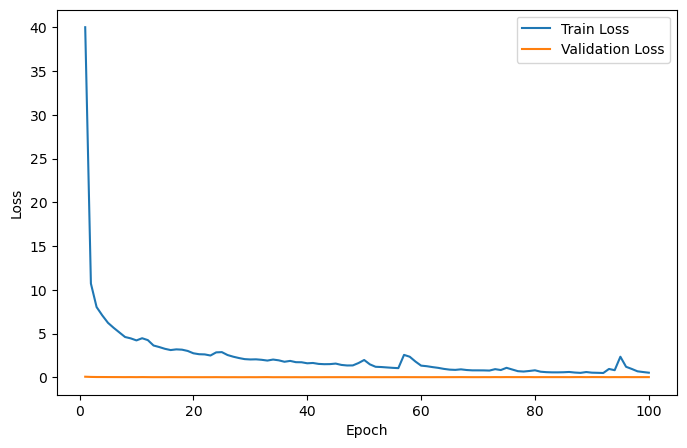

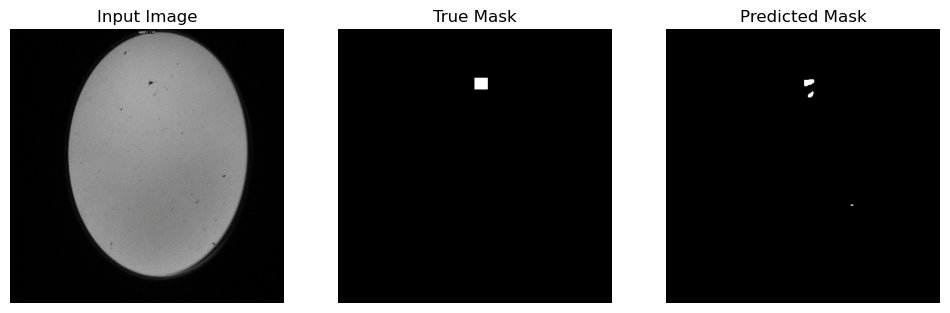

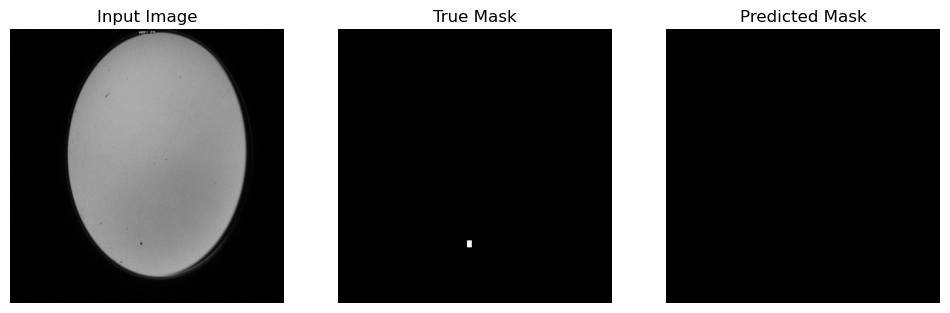

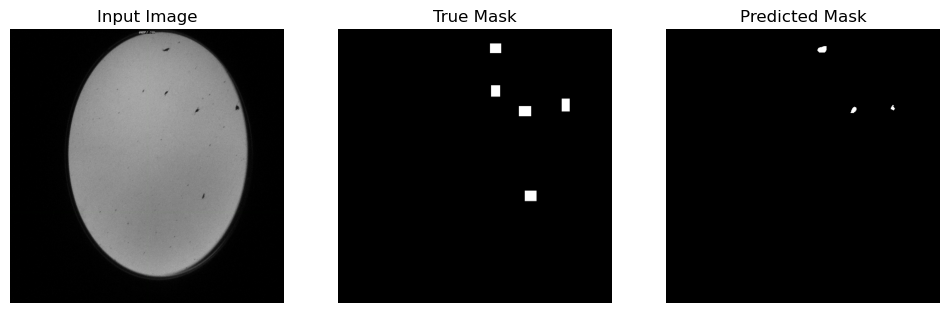

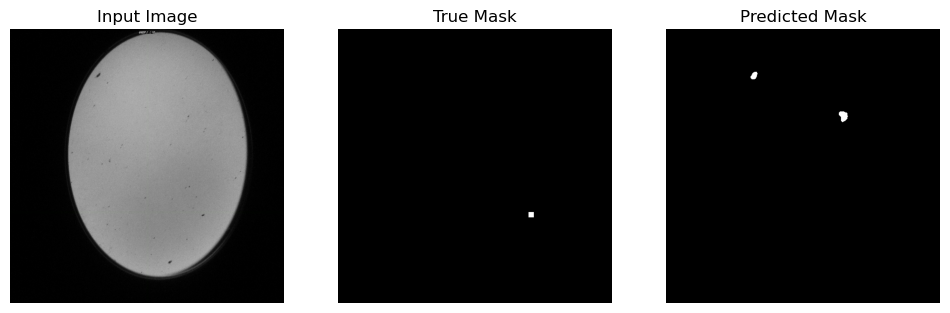

...

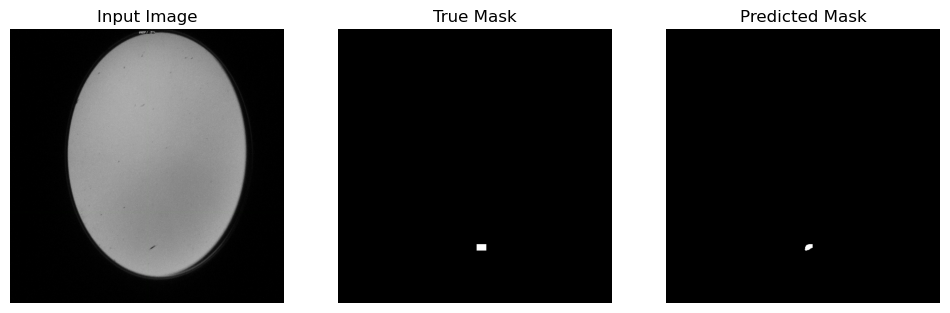

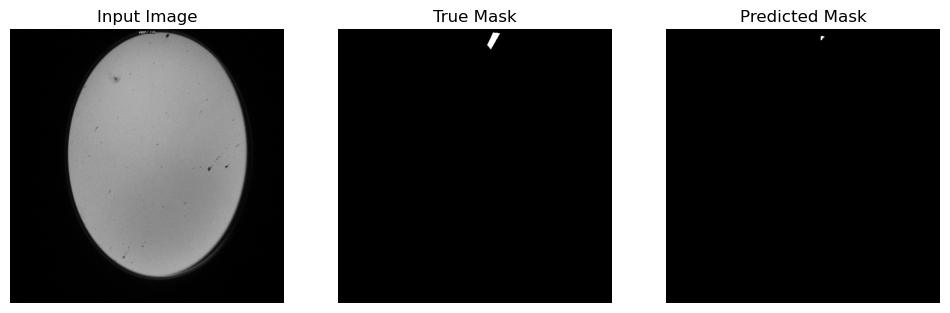

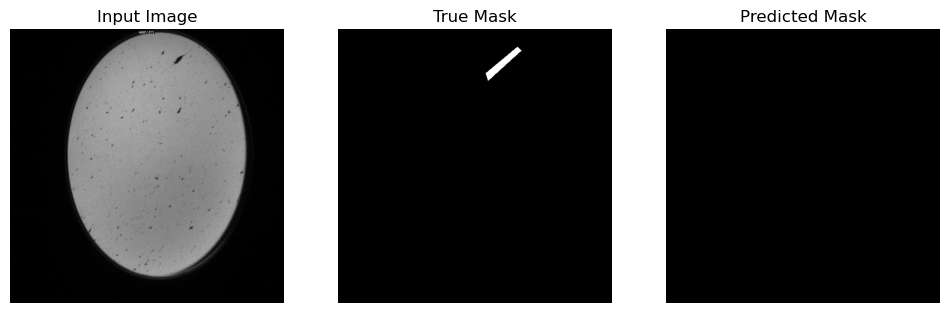

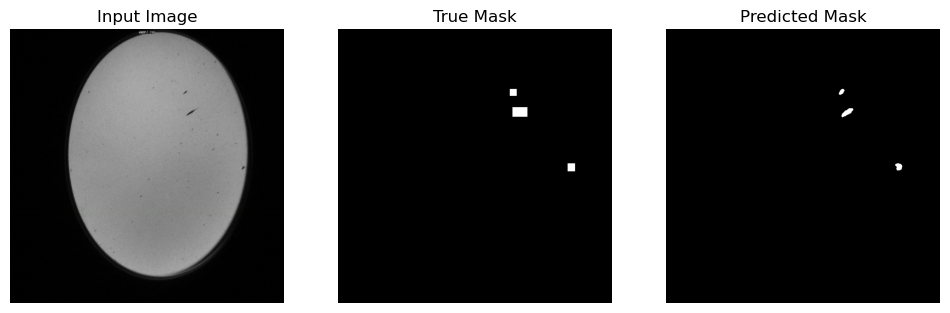

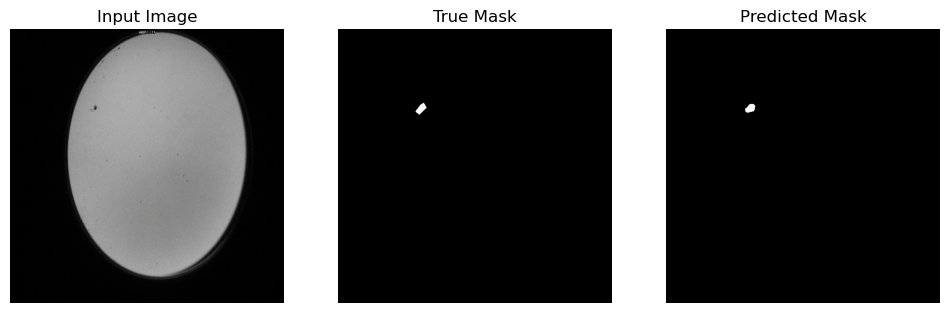

In [15]:
model = UNet(input_channels=3, start_neurons=16, dropout_rate=0.1).to(device)
criterion = nn.BCEWithLogitsLoss()  # Binary Cross Entropy with Logits loss for binary segmentation
optimizer = optim.RAdam(model.parameters(), lr=0.001)
# Train the model
num_epochs = 100
train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs)

# Test the model and visualize the results
test_model(model, test_loader)

Epoch 1/100, Train Loss: 22.4641, Val Loss: 0.0475
Epoch 2/100, Train Loss: 8.6520, Val Loss: 0.0540
Epoch 3/100, Train Loss: 7.1900, Val Loss: 0.0313
Epoch 4/100, Train Loss: 6.1853, Val Loss: 0.0275
Epoch 5/100, Train Loss: 5.3951, Val Loss: 0.0267
Epoch 6/100, Train Loss: 4.5210, Val Loss: 0.0235
Epoch 7/100, Train Loss: 4.4847, Val Loss: 0.0249
Epoch 8/100, Train Loss: 4.0240, Val Loss: 0.0380
Epoch 9/100, Train Loss: 3.7241, Val Loss: 0.0199
Epoch 10/100, Train Loss: 3.6304, Val Loss: 0.0168
Epoch 11/100, Train Loss: 3.4524, Val Loss: 0.0187
Epoch 12/100, Train Loss: 3.5543, Val Loss: 0.0182
Epoch 13/100, Train Loss: 3.1442, Val Loss: 0.0175
Epoch 14/100, Train Loss: 3.2859, Val Loss: 0.0177
Epoch 15/100, Train Loss: 3.3944, Val Loss: 0.0169
Epoch 16/100, Train Loss: 3.0887, Val Loss: 0.0167
Epoch 17/100, Train Loss: 2.7434, Val Loss: 0.0161
Epoch 18/100, Train Loss: 2.7739, Val Loss: 0.0168
Epoch 19/100, Train Loss: 2.6676, Val Loss: 0.0173
Epoch 20/100, Train Loss: 2.8204, Val L

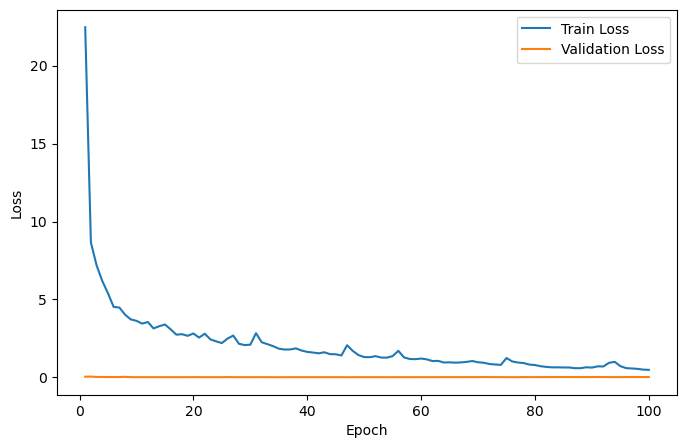

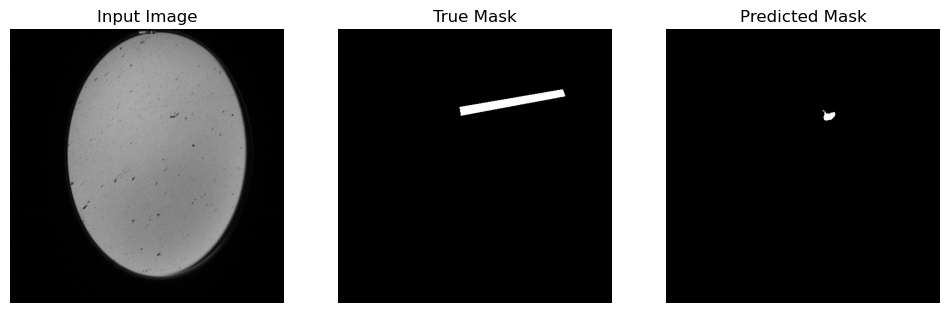

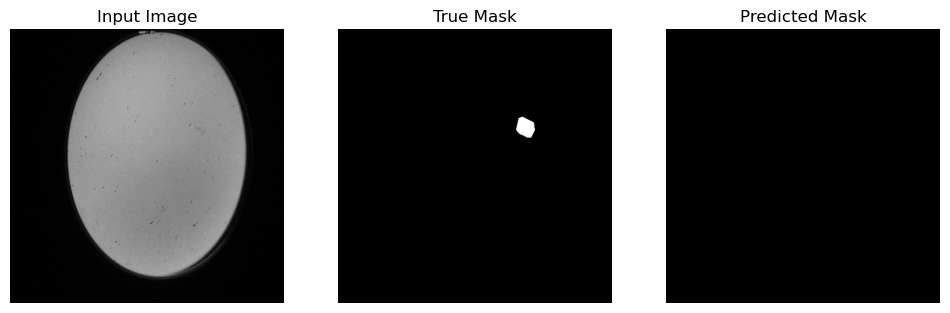

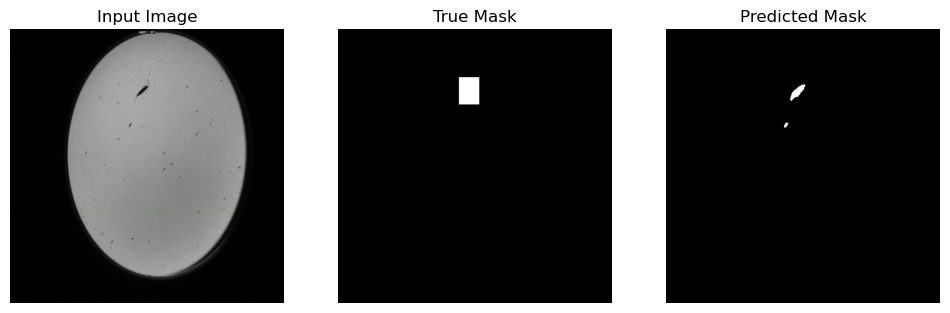

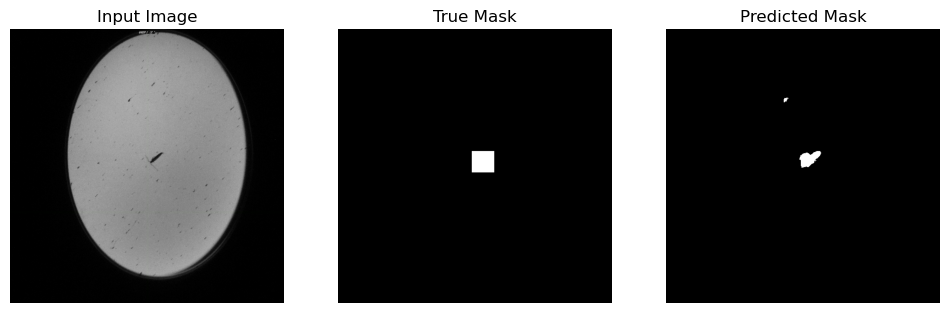

...

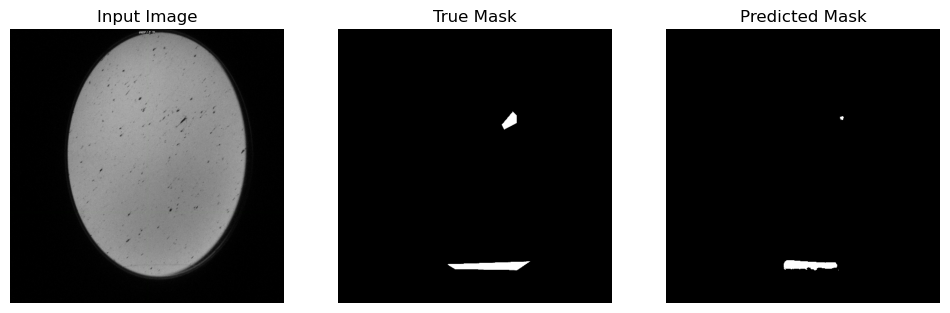

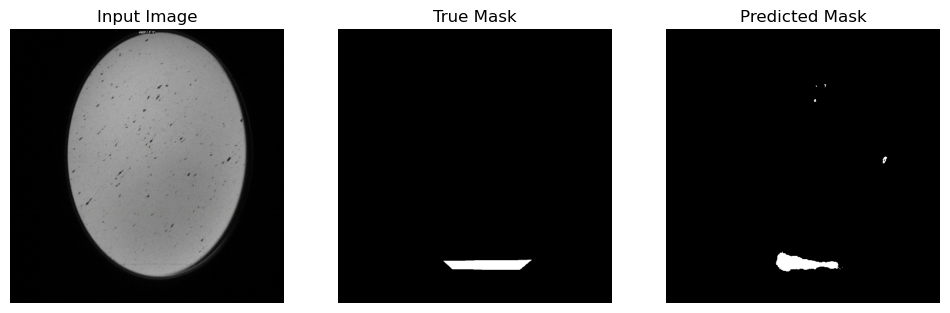

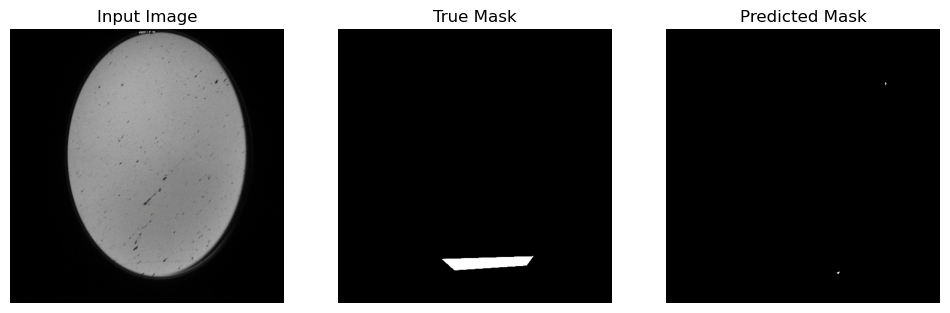

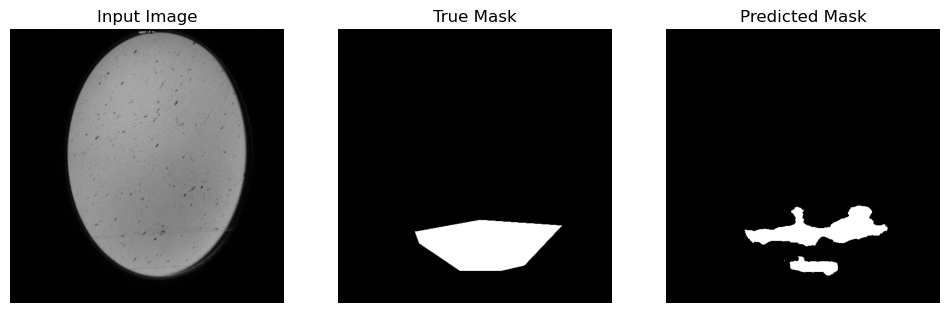

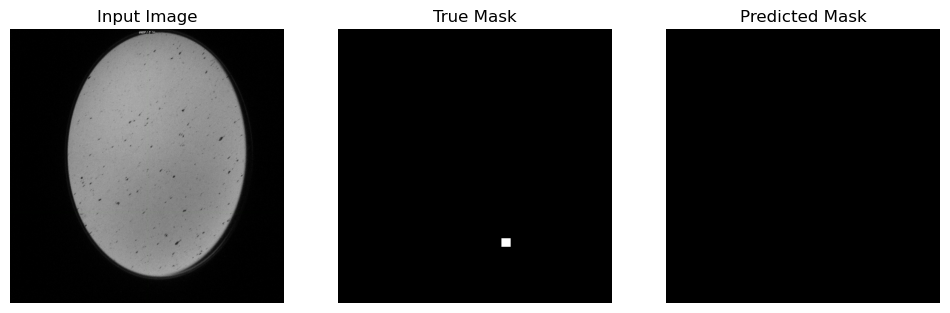

In [15]:
# model = UNet(input_channels=3, start_neurons=16, dropout_rate=0.1).to(device)
# criterion = nn.BCEWithLogitsLoss()  # Binary Cross Entropy with Logits loss for binary segmentation
# optimizer = optim.RAdam(model.parameters(), lr=0.001)
# # Train the model
# num_epochs = 100
# train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs)

# # Test the model and visualize the results
# test_model(model, test_loader)

# below result after modyfying images

Epoch 1/100, Train Loss: 38.1410, Val Loss: 0.1495
Epoch 2/100, Train Loss: 11.9553, Val Loss: 0.1512
Epoch 3/100, Train Loss: 8.6239, Val Loss: 0.0626
Epoch 4/100, Train Loss: 4.9703, Val Loss: 0.1763
Epoch 5/100, Train Loss: 2.8509, Val Loss: 0.2261
Epoch 6/100, Train Loss: 1.8486, Val Loss: 0.0503
Epoch 7/100, Train Loss: 1.2761, Val Loss: 0.0110
Epoch 8/100, Train Loss: 0.9276, Val Loss: 0.0069
Epoch 9/100, Train Loss: 0.6960, Val Loss: 0.0057
Epoch 10/100, Train Loss: 0.5430, Val Loss: 0.0053
Epoch 11/100, Train Loss: 0.4377, Val Loss: 0.0042
Epoch 12/100, Train Loss: 0.4223, Val Loss: 0.0745
Epoch 13/100, Train Loss: 0.4321, Val Loss: 0.1393
Epoch 14/100, Train Loss: 0.2711, Val Loss: 0.0084
Epoch 15/100, Train Loss: 0.2251, Val Loss: 0.0020
Epoch 16/100, Train Loss: 0.1920, Val Loss: 0.0022
Epoch 17/100, Train Loss: 0.1649, Val Loss: 0.0017
Epoch 18/100, Train Loss: 0.1443, Val Loss: 0.0011
Epoch 19/100, Train Loss: 0.1240, Val Loss: 0.0008
Epoch 20/100, Train Loss: 0.1002, Val 

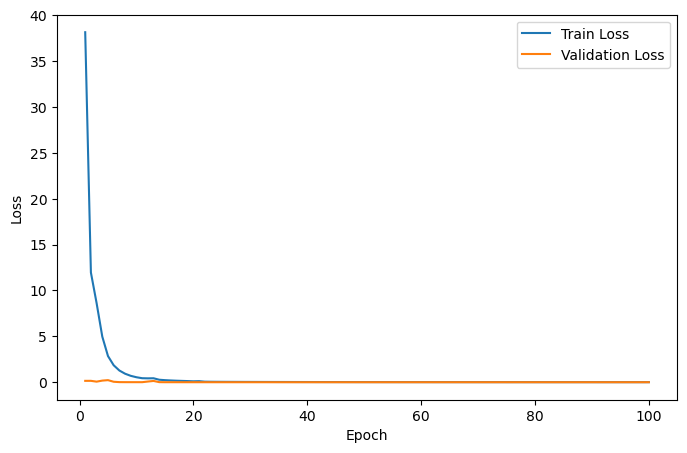

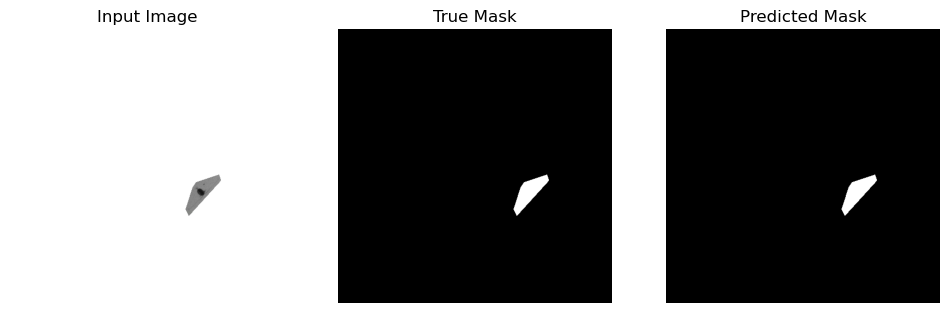

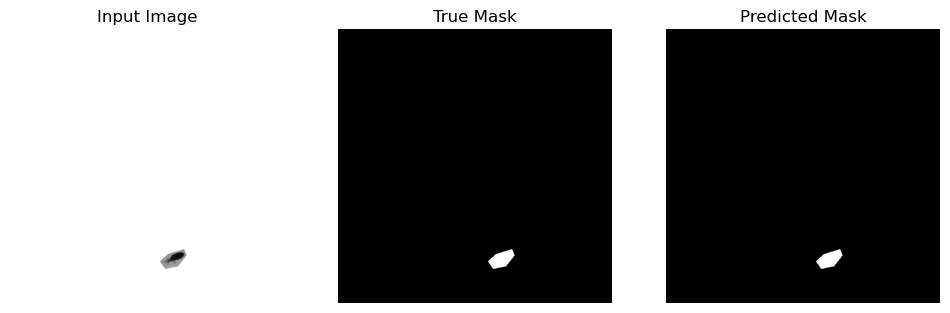

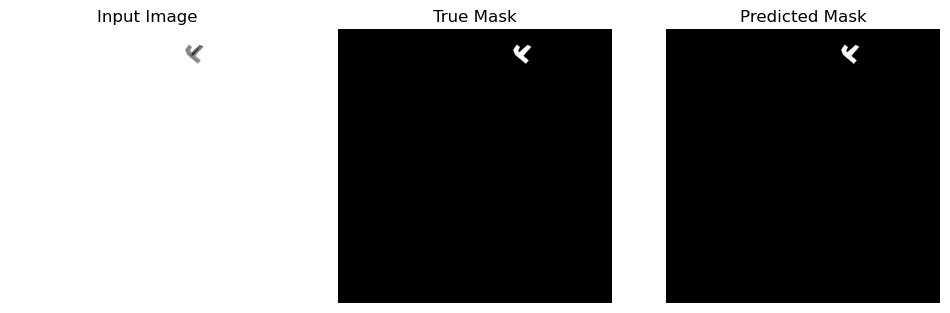

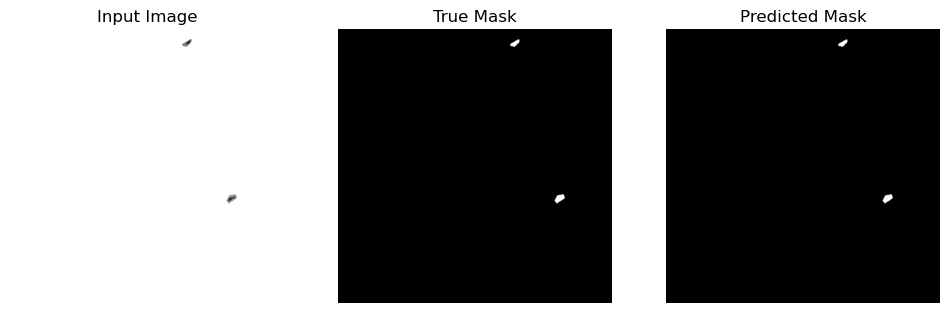

...

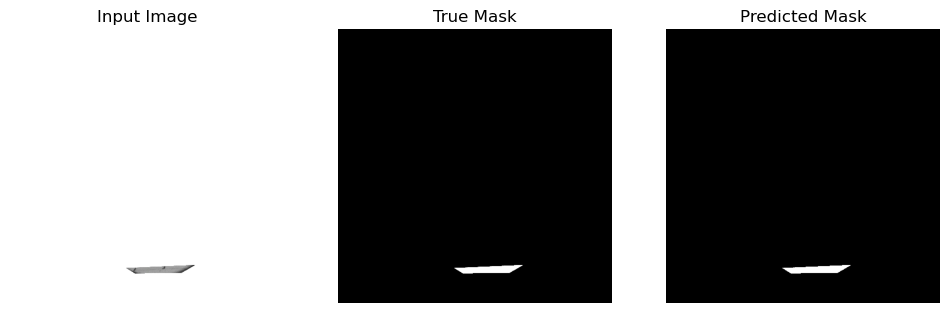

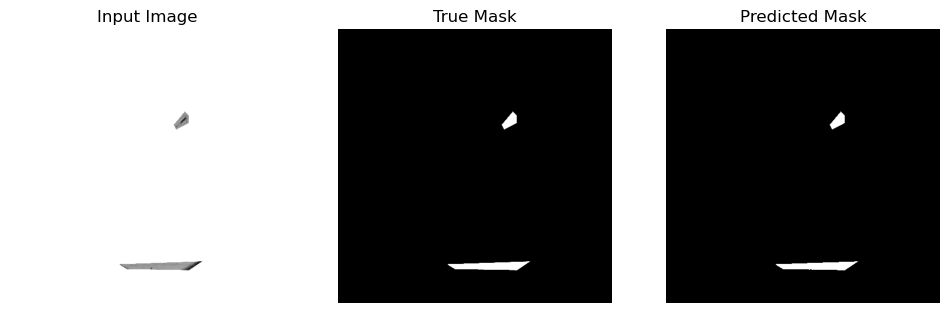

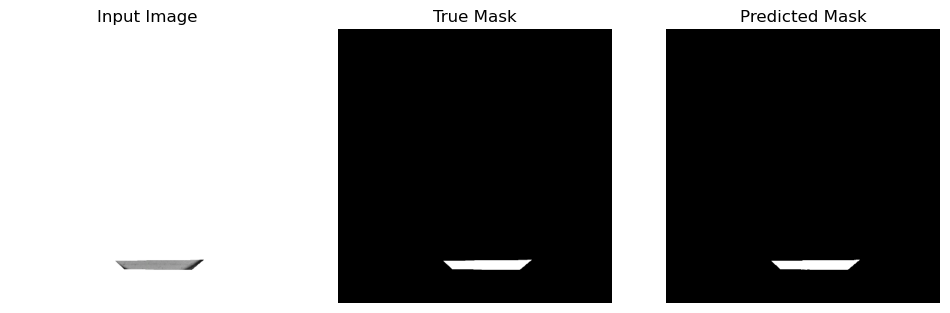

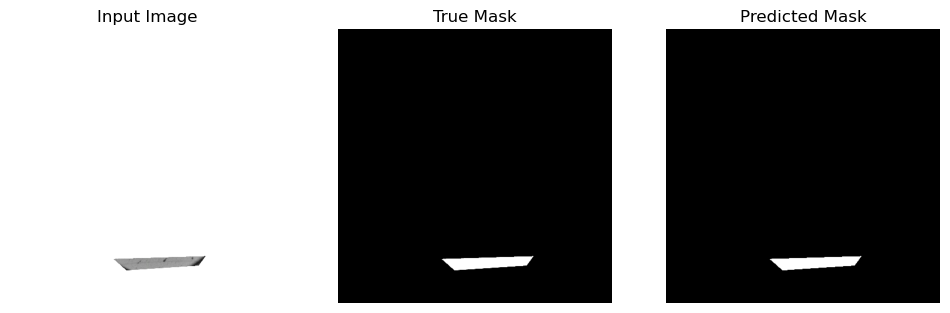

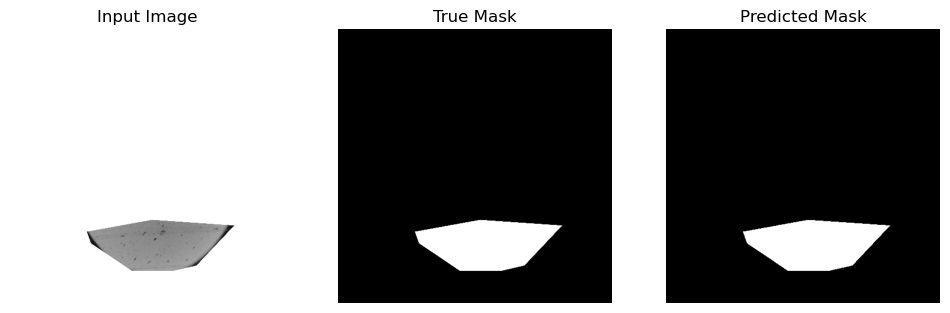

In [113]:
# model = UNet().to(device)
# criterion = nn.BCEWithLogitsLoss()  # Binary Cross Entropy with Logits loss for binary segmentation
# optimizer = optim.Adam(model.parameters(), lr=0.001)
# # Train the model
# num_epochs = 100
# train_model(model, criterion, optimizer, train_loader, val_loader, num_epochs)

# # Test the model and visualize the results
# test_model(model, test_loader)